<a href="https://colab.research.google.com/github/Farlom/FixMaster/blob/main/car_traffic_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

Fri Apr 14 08:25:19 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
path = r"/content/drive/MyDrive/IT/AI/car_traffic_detection/"

Mounted at /content/drive


In [ ]:
import torch

In [ ]:
#@title Загрузка модели
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

/usr/local/lib/python3.9/dist-packages/torch/hub.py:286: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
requirements: YOLOv5 requirement "gitpython>=3.1.30" not found, attempting AutoUpdate...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 11.

In [ ]:
# # Model
# model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)
model.classes = [2, 5, 7] #машины грузовики и автобусы
# # Images
# imgs = ['https://api.time.com/wp-content/uploads/2018/12/GettyImages-1057484678.jpg?quality=85&w=2405']  # batch of images

# # Inference
# results = model(imgs)
# # asda = cv.imread(results)
# # Results
# results.print()
# # results.show()  # or .show()
# # type(results)
# results.pandas()
# # results.xyxy[0]  # img1 predictions (tensor)
# # results.pandas().xyxy[0]  # img1 predictions (pandas)

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow

In [ ]:
cap = cv.VideoCapture(path+'sampo_cams.flv')

In [ ]:
FPS = int(cap.get(cv.CAP_PROP_FPS))
FPS

25

In [ ]:
duration = int(cap.get(cv.CAP_PROP_FRAME_COUNT) / FPS)
duration

62

In [ ]:
WIDTH = int(cap.get(cv.CAP_PROP_FRAME_WIDTH))
HEIGHT = int(cap.get(cv.CAP_PROP_FRAME_HEIGHT))
WIDTH, HEIGHT

(1280, 720)

In [ ]:
# fourcc = cv.VideoWriter_fourcc(*'XVID')
# out = cv.VideoWriter(path+'output.avi', fourcc, 20.0, (WIDTH,  HEIGHT))


In [ ]:
# cap = cv.VideoCapture(path+'sampo_cams.flv')
second = 0
frame_counter = 1
frames = []
classes = []
while cap.isOpened():
    ret, frame = cap.read()
    
    if not ret:
        print("Can't receive frame (stream end?). Exiting ...")
        break
    else:
        # запись каждого 5 кадра в массив
        # if (frame_counter % 5 == 0):
        #   frames.append(frame)

        frames.append(frame)
        # сохранение батча кадров из секунды видео
        if frame_counter % FPS == 0: # 25 сделать в фпс
          print(f'Second: {second}')
          results = model(frames)
          results.save(save_dir=path+f'frames/second_{second}/')
          frames = []
          second += 1
          
          break
        frame_counter += 1

cap.release()


Second: 0


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_03


In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
# defining labels
activities = ['car', 'truck', 'bus']
  
# portion covered by each label
# slices = [3, 7, 8, ]
  
# color for each label
colors = ['r', 'g', 'b']
# img = plt.imread(path+"image3.jpg")  
# plotting the pie chart
# plt.pie(slices, labels = activities, colors=colors, 
#         startangle=90, shadow = True,
#         radius = 1.2, autopct = '%1i%%')
  
# # plotting legend
# plt.legend()
  
# # showing the plot
# plt.show()

In [ ]:
import os

In [ ]:
cap = cv.VideoCapture(path+'sampo_cams.flv')
second = 0
frame_counter = 1
count = 0
frames = []
classes = []

path2 = os.path.join(path, 'frames')
os.mkdir(path2)
path2 = os.path.join(path+'frames/', f'plot_{second}')
os.mkdir(path2)

while cap.isOpened():
    ret, frame = cap.read()
    
    if not ret:
        print("Can't receive frame (stream end?). Exiting ...")
        break
    else:
        # запись каждого 5 кадра в массив
        # if (frame_counter % 5 == 0):
        #   frames.append(frame)

        frames.append(frame)
        results = model(frame)

        slices = [
            (results.pandas().xyxy[0])[results.pandas().xyxy[0]['name'] == 'car'].count()[0],
            (results.pandas().xyxy[0])[results.pandas().xyxy[0]['name'] == 'truck'].count()[0],
            (results.pandas().xyxy[0])[results.pandas().xyxy[0]['name'] == 'bus'].count()[0]
        ]

        plt.pie(slices, labels = activities, colors=colors, 
          startangle=90, shadow = True,
          radius = 1.2, autopct = '%1i%%')
  
        # plt.show()
        plt.savefig(path+f'frames/plot_{second}/plot{count}')
        plt.clf()
        count += 1

        # сохранение батча кадров из секунды видео
        if frame_counter % FPS == 0: # 25 сделать в фпс
          print(f'Second: {second}')
          results = model(frames)
          results.save(save_dir=path+f'frames/second_{second}/')
          frames = []
          second += 1
          count = 0
          path2 = os.path.join(path+'frames/', f'plot_{second}')
          os.mkdir(path2)

        frame_counter += 1

cap.release()


Second: 0


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_0


Second: 1


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_1


Second: 2


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_2


Second: 3


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_3


Second: 4


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_4


Second: 5


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_5


Second: 6


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_6


Second: 7


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_7


Second: 8


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_8


Second: 9


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_9


Second: 10


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_10


Second: 11


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_11


Second: 12


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_12


Second: 13


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_13


Second: 14


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_14


Second: 15


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_15


Second: 16


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_16


Second: 17


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_17


Second: 18


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_18


Second: 19


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_19


Second: 20


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_20


Second: 21


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_21


Second: 22


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_22


Second: 23


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_23


Second: 24


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_24


Second: 25


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_25


Second: 26


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_26


Second: 27


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_27


Second: 28


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_28


Second: 29


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_29


Second: 30


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_30


Second: 31


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_31


Second: 32


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_32


Second: 33


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_33


Second: 34


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_34


Second: 35


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_35


Second: 36


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_36


Second: 37


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_37


Second: 38


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_38


Second: 39


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_39


Second: 40


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_40


Second: 41


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_41


Second: 42


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_42


Second: 43


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_43


Second: 44


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_44


Second: 45


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_45


Second: 46


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_46


Second: 47


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_47


Second: 48


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_48


Second: 49


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_49


Second: 50


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_50


Second: 51


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_51


Second: 52


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_52


Second: 53


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_53


Second: 54


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_54


Second: 55


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_55


Second: 56


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_56


Second: 57


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_57


Second: 58


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_58


Second: 59


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_59


Second: 60


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_60


Second: 61


Saved 25 images to /content/drive/MyDrive/IT/AI/car_traffic_detection/frames/second_61


Can't receive frame (stream end?). Exiting ...


<Figure size 700x350 with 0 Axes>

In [ ]:
# fourcc = cv.VideoWriter_fourcc(*'XVID')
# out = cv.VideoWriter(path+'output.avi', fourcc, 5, (int(WIDTH),  int(HEIGHT)))


In [ ]:
# fourcc = cv.VideoWriter_fourcc(*'XVID')
# out = cv.VideoWriter(path+'output.avi', fourcc, 20.0, (int(WIDTH),  int(HEIGHT)))
# img = cv.imread(path+ 'image3.jpg')
# for i in range(100):
#   out.write(img)
# out.release()

In [ ]:
path

'/content/drive/MyDrive/IT/AI/car_traffic_detection/'

In [ ]:
# os.listdir(path+'frames6/')

In [ ]:
# path+'frames6/'

'/content/drive/MyDrive/IT/AI/car_traffic_detection/frames6/'

In [ ]:
import os

In [ ]:
fourcc = cv.VideoWriter_fourcc(*'XVID')
out = cv.VideoWriter(path+'output.avi', fourcc, FPS, (1920, 1080))

In [ ]:
from PIL import Image
import numpy as np

In [ ]:
# img = Image.new('RGB', (1920, 1080), color='white')
# img.paste(Image.open(path+'frames/second_0/image0.jpg'), (0,0))
# img.paste(Image.open(path+'frames/plot_0/plot0.png'), (1920-700, 1080-350))
# img.show()

In [ ]:
for i in range(duration):
  # print(i)
  for j in range(25):
    img = Image.new('RGB', (1920, 1080), color='white')
    img.paste(Image.open(path+f'frames/second_{i}/image{j}.jpg'), (0,0))
    img.paste(Image.open(path+f'frames/plot_{i}/plot{j}.png'), (1920-700, 1080-350))
    cv2_img = np.array(img) 
    out.write(cv2_img)

out.release()

  # pass

In [ ]:
for subdir in os.listdir(path+'frames/'):
  print(subdir)
  # for filename in os.listdir(path+f'frames/{subdir}'):
  #   img = cv.imread(path+f'frames/{subdir}/{filename}')
  #   out.write(img)

out.release()
  # for filename in os.listdir(path+f'frames/second_')

plot_0
second_0
plot_1
second_1
plot_2
second_2
plot_3
second_3
plot_4
second_4
plot_5
second_5
plot_6
second_6
plot_7
second_7
plot_8
second_8
plot_9
second_9
plot_10
second_10
plot_11
second_11
plot_12
second_12
plot_13
second_13
plot_14
second_14
plot_15
second_15
plot_16
second_16
plot_17
second_17
plot_18
second_18
plot_19
second_19
plot_20
second_20
plot_21
second_21
plot_22
second_22
plot_23
second_23
plot_24
second_24
plot_25
second_25
plot_26
second_26
plot_27
second_27
plot_28
second_28
plot_29
second_29
plot_30
second_30
plot_31
second_31
plot_32
second_32
plot_33
second_33
plot_34
second_34
plot_35
second_35
plot_36
second_36
plot_37
second_37
plot_38
second_38
plot_39
second_39
plot_40
second_40
plot_41
second_41
plot_42
second_42
plot_43
second_43
plot_44
second_44
plot_45
second_45
plot_46
second_46
plot_47
second_47
plot_48
second_48
plot_49
second_49
plot_50
second_50
plot_51
second_51
plot_52
second_52
plot_53
second_53
plot_54
second_54
plot_55
second_55
plot_56
seco

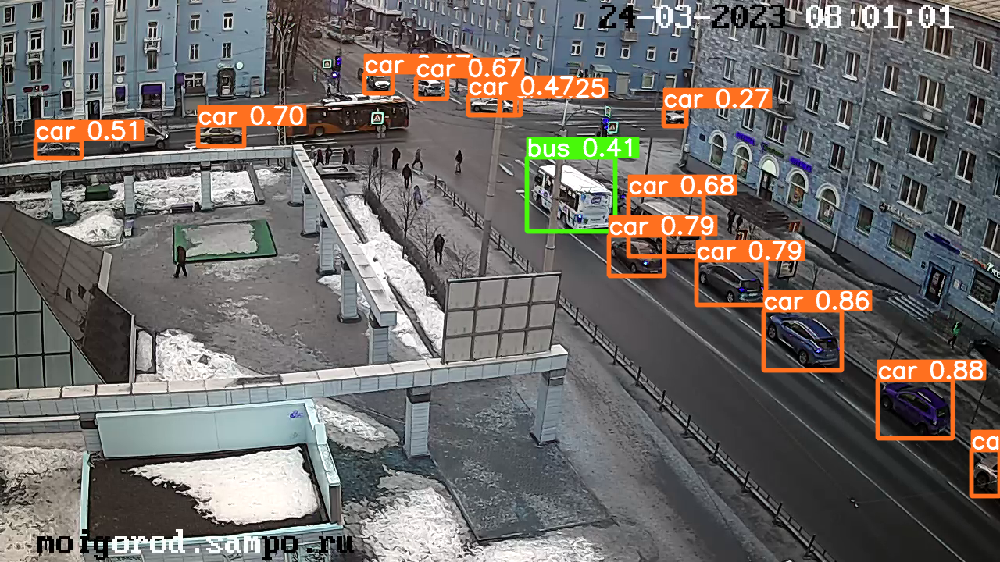

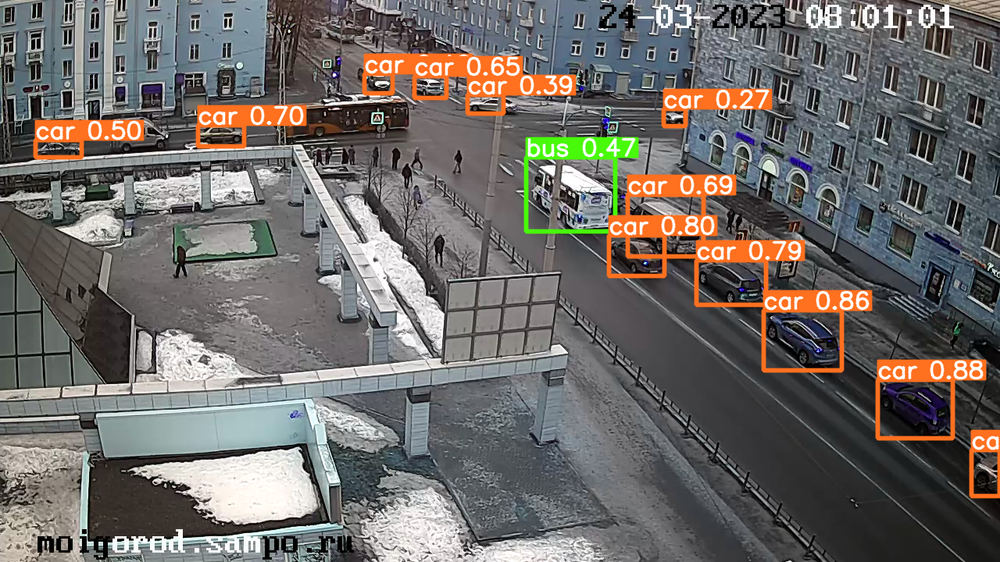

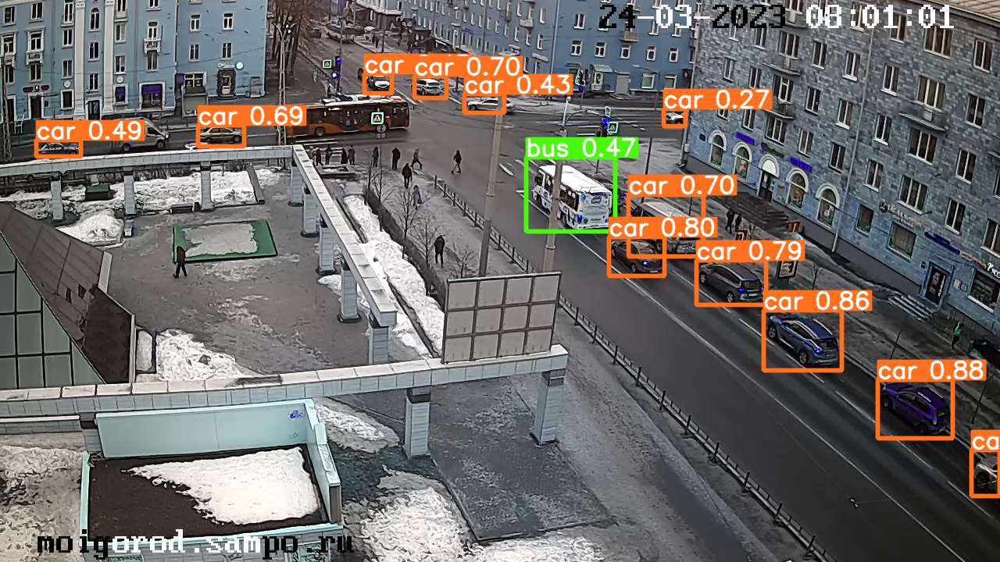

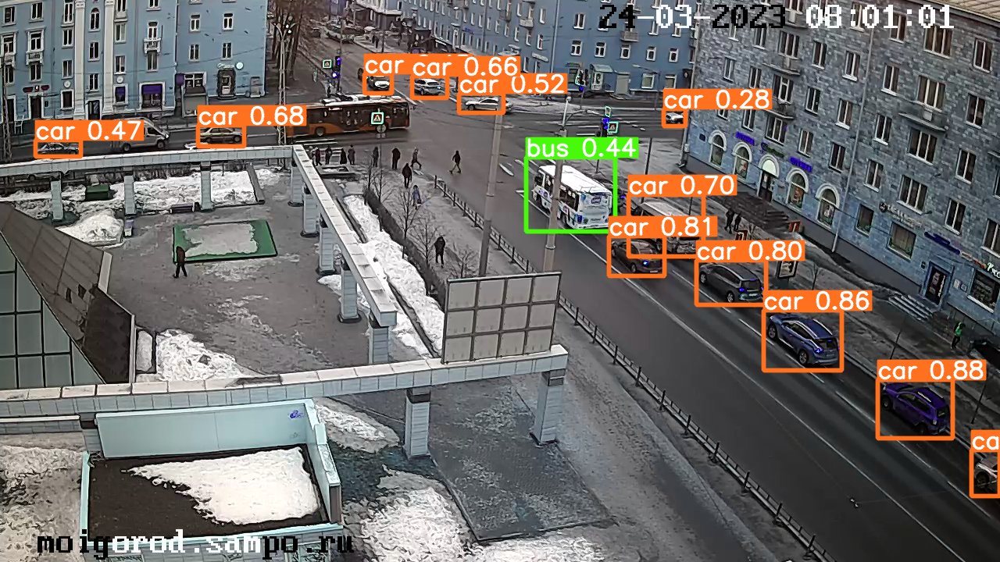

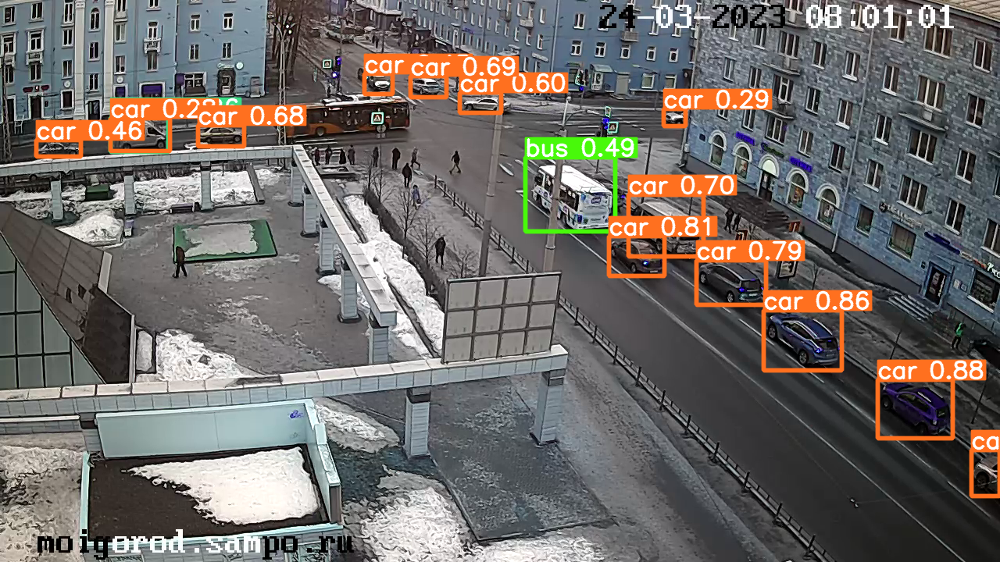

...

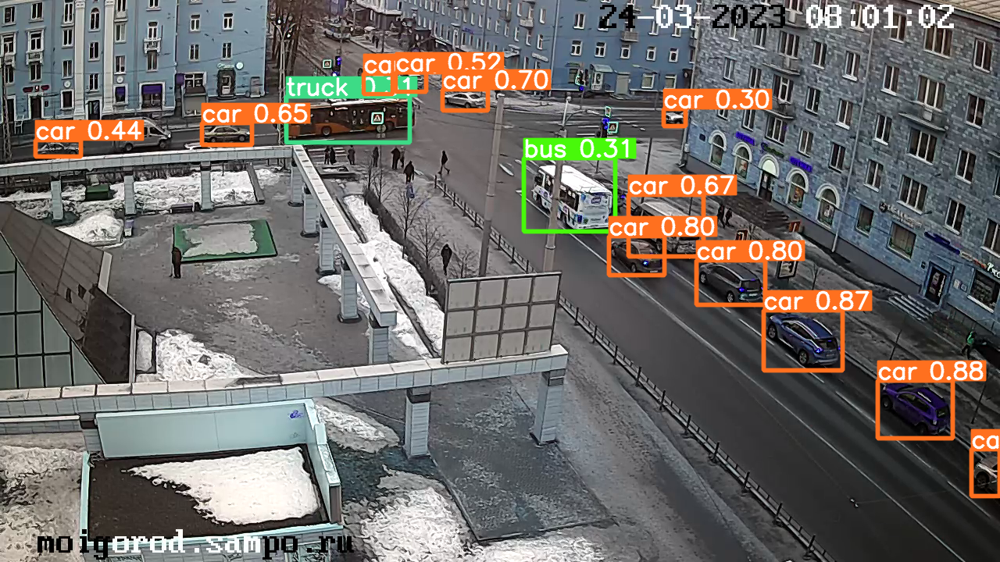

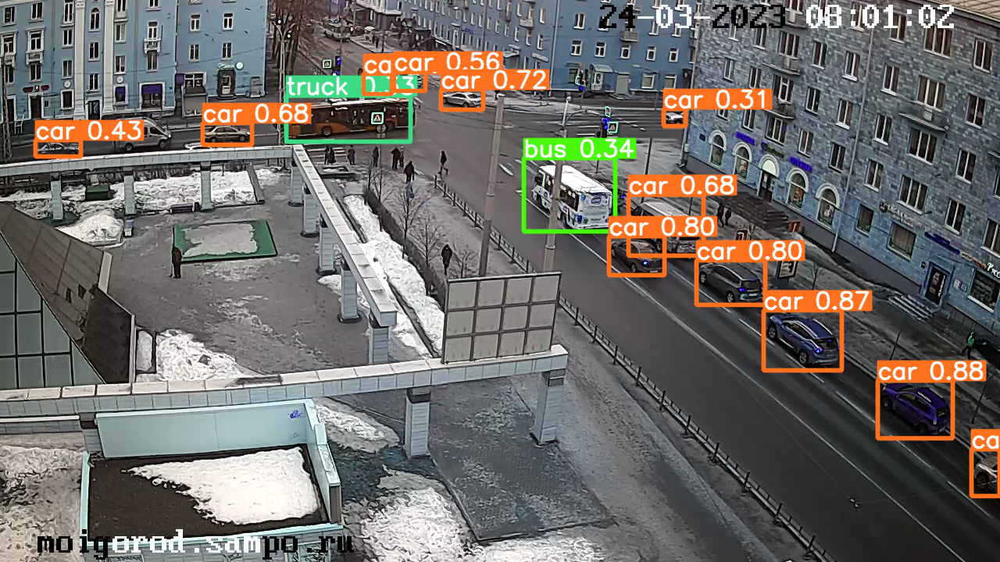

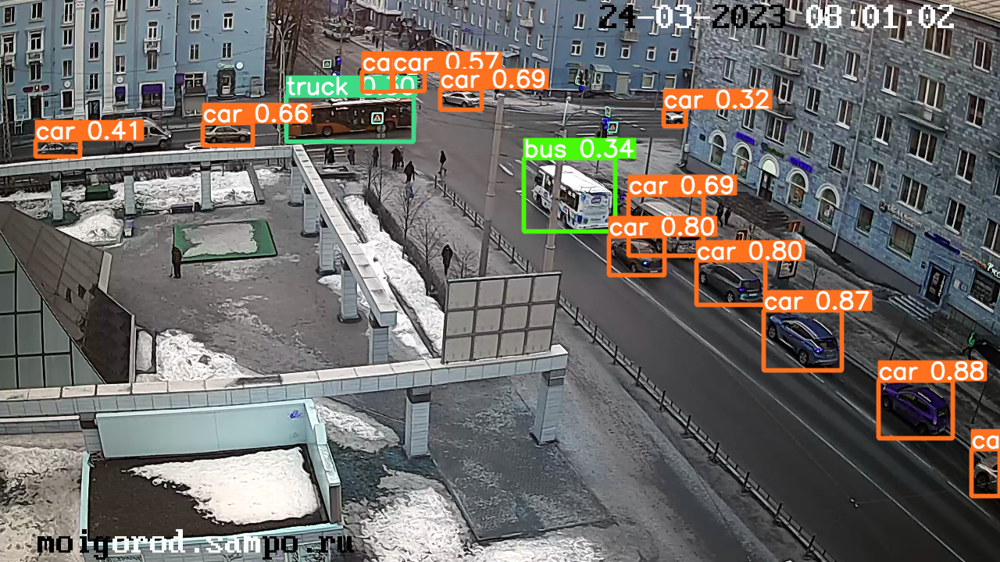

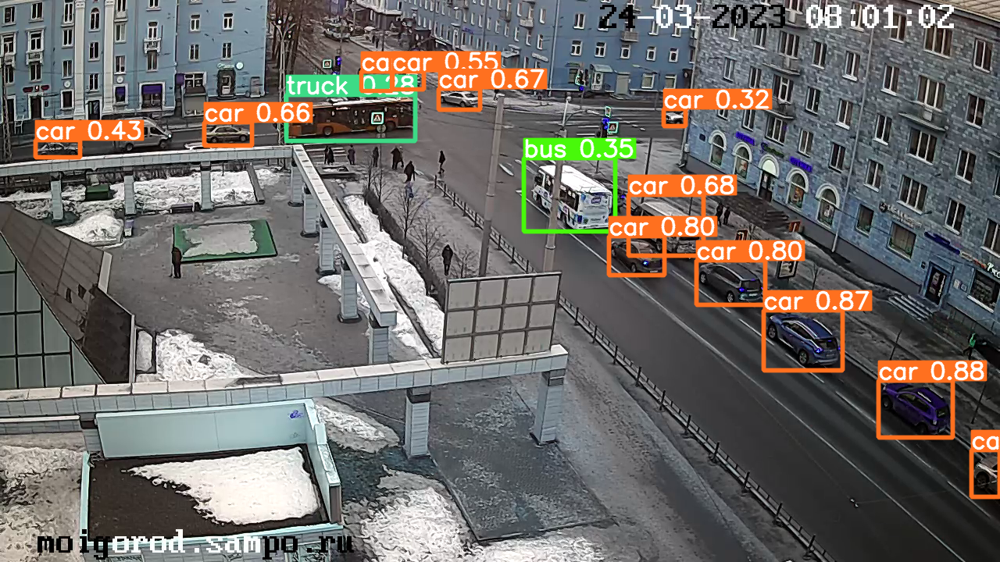

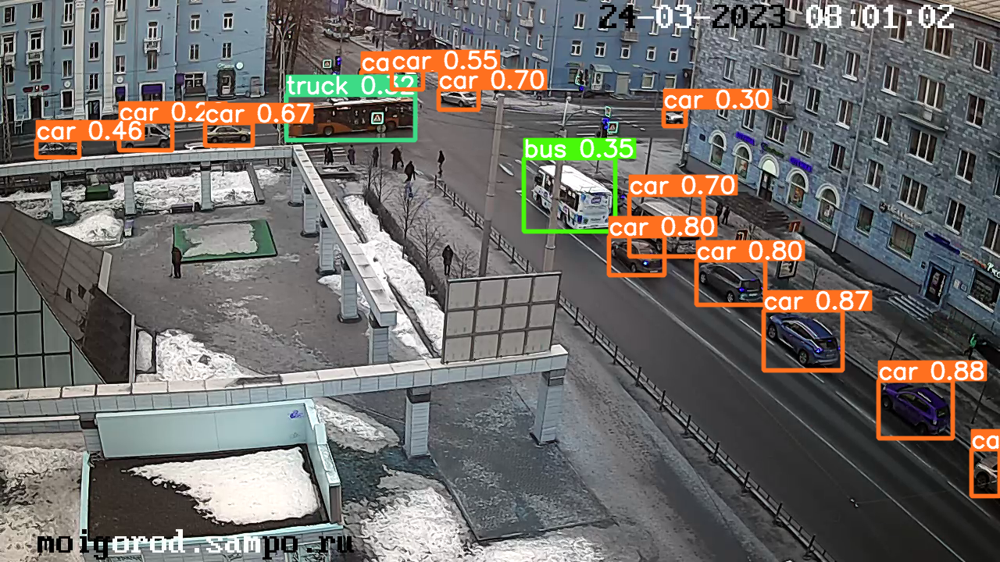

In [ ]:
results.pandas().xyxy[0]
results.show()

In [ ]:
# len(os.listdir(path+'frames/'))

In [ ]:
# fourcc = cv.VideoWriter_fourcc(*'XVID')
# out = cv.VideoWriter(path+'output1.avi', fourcc, 1, (int(WIDTH),  int(HEIGHT)))

In [ ]:

# counter = 0
# for filename in os.listdir(path+'frames9/'):
#   # img = cv.imread(cv.samples.findFile(path+'frames9/'+filename), cv.IMREAD_GRAYSCALE)
#   img = cv.imread(path+'frames9/'+filename)
#   out.write(img)
#   # print(filename)
#   # if counter == 0:
#   #   counter += 1
# cv2_imshow(img)
# # print(type(img))
# out.release()

In [ ]:
# out.release()

In [ ]:
# height, width =  img_arr[0].shape
# size = (width, height)
# fourcc = cv.VideoWriter_fourcc(*'XVID')
# out = cv.VideoWriter(path+'output10.avi', fourcc, 20.0, size)

# for i in range(len(img_arr)):
#     out.write(img_arr[i])
#     print(height, width)
# out.release()

In [ ]:
# img = cv.imread(cv.samples.findFile(path+'frames6/'+filename), cv.IMREAD_GRAYSCALE)
# cv2_imshow(img)

In [ ]:
(results.pandas().xyxy[0])[results.pandas().xyxy[0]['name'] == 'car'].count()[0]

# type(results.pandas().xyxy[0])

13

In [ ]:
(results.pandas().xyxy[0])[results.pandas().xyxy[0]['name'] == 'bus'].count()[0]

1

In [ ]:
(results.pandas().xyxy[0])[results.pandas().xyxy[0]['name'] == 'truck'].count()[0]

0

In [ ]:
# def forSecond(frame_number, output_arrays, count_arrays, average_count, returned_frame):

#     plt.clf()

#     this_colors = []
#     labels = []
#     sizes = []

#     counter = 0

#     for eachItem in average_count:
#         counter += 1
#         labels.append(eachItem + " = " + str(average_count[eachItem]))
#         sizes.append(average_count[eachItem])
#         this_colors.append(color_index[eachItem])

#     global resized

#     if (resized == False):
#         manager = plt.get_current_fig_manager()
#         manager.resize(width=1200, height=600)
#         resized = True

#     plt.subplot(1, 2, 1)
#     plt.title("Second : " + str(frame_number))
#     plt.axis("off")
#     plt.imshow(returned_frame, interpolation="none")

#     plt.subplot(1, 2, 2)
#     plt.title("Analysis: " + str(frame_number))
#     plt.pie(sizes, labels=labels, colors=this_colors, shadow=True, startangle=140, autopct="%1.1f%%")

#     plt.pause(0.01)



# video_detector = VideoObjectDetection()
# video_detector.setModelTypeAsYOLOv3()
# video_detector.setModelPath(os.path.join(execution_path, "yolo.h5"))
# video_detector.loadModel(detection_speed="fast")

# plt.show()

# video_detector.detectObjectsFromVideo(input_file_path=os.path.join(execution_path, "traffic-mini.mp4"), 
#                                       save_detected_video=False ,  frames_per_second=20, per_second_function=forSecond, 
#                                       minimum_percentage_probability=30, return_detected_frame=True, log_progress=True)

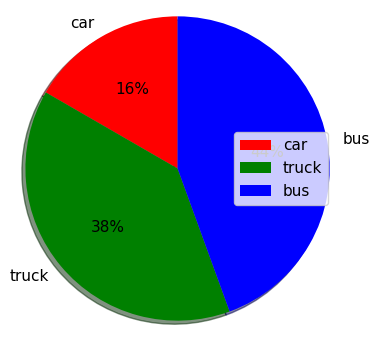

In [ ]:

import matplotlib.pyplot as plt
%matplotlib inline
# defining labels
activities = ['car', 'truck', 'bus']
  
# portion covered by each label
slices = [3, 7, 8, ]
  
# color for each label
colors = ['r', 'g', 'b']
# img = plt.imread(path+"image3.jpg")  
# plotting the pie chart
plt.pie(slices, labels = activities, colors=colors, 
        startangle=90, shadow = True,
        radius = 1.2, autopct = '%1i%%')
  
# plotting legend
plt.legend()
  
# showing the plot
plt.show()

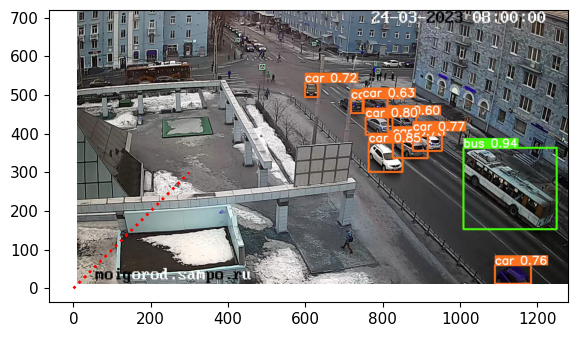

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True
im = plt.imread(path+"image3.jpg")
fig, ax = plt.subplots()
im = ax.imshow(im, extent=[10, WIDTH, 10, HEIGHT])
x = np.array(range(300))
ax.plot(x, x, ls='dotted', linewidth=2, color='red')
plt.show()

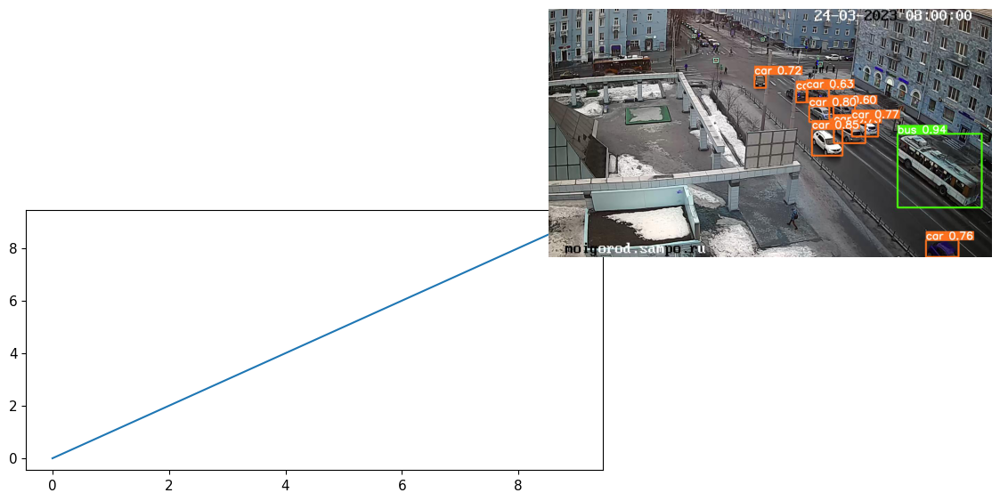

In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams["figure.figsize"] = [7.00, 3.50]
plt.rcParams["figure.autolayout"] = True
im = plt.imread(path+"image3.jpg") # insert local path of the image.
fig, ax = plt.subplots()
ax.plot(range(10))
newax = fig.add_axes([0.8,0.8,0.8,0.8], anchor='NE', zorder=1)
newax.imshow(im)
newax.axis('off')
plt.show()